# Workshop: Retraining cellpose on a small labeled dataset
- This notebook is based on the run_cellpose2 notebook (https://github.com/MouseLand/cellpose/blob/main/notebooks/run_cellpose_2.ipynb)
- We add some intermediate visualizations and try to recreate Figure 2 of the cellpose paper (https://www.nature.com/articles/s41592-020-01018-x/figures/2)

# Imports and global variables

In [1]:
!nvcc --version
!nvidia-smi

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Jun__8_16:59:34_Pacific_Daylight_Time_2022
Cuda compilation tools, release 11.7, V11.7.99
Build cuda_11.7.r11.7/compiler.31442593_0
Sun Mar 12 15:10:06 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 517.66       Driver Version: 517.66       CUDA Version: 11.7     |
|-------------------------------+----------------------+----------------------+
| GPU  Name            TCC/WDDM | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Quadro T1000 wi... WDDM  | 00000000:01:00.0  On |                  N/A |
| N/A   50C    P8     3W /  N/A |    390MiB /  4096MiB |     20%      Default |
|                     

In [2]:
import os, shutil
os.chdir(os.path.join('..', 'src'))
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import seaborn as sns
from skimage.color import label2rgb
from cellpose import core, utils, io, models, metrics
from glob import glob
import torch
from sklearn import manifold
from sklearn.preprocessing import StandardScaler
%load_ext autoreload
%autoreload 2

from helper_functions import cellpose_img_load, dense_from_acdc


use_GPU = core.use_gpu()
yn = ['NO', 'YES']
print(f'>>> GPU activated? {yn[use_GPU]}')


C:\Users\mairhoermann\Anaconda3\envs\antholz23\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


>>> GPU activated? YES


In [3]:
train_dir = os.path.join('..', 'data', 'train')
test_dir = os.path.join('..', 'data', 'test')

In [4]:
train_img_paths = sorted(glob(os.path.join(train_dir, '*img.png')))
train_mask_paths = sorted(glob(os.path.join(train_dir, '*masks.png')))
test_img_paths = sorted(glob(os.path.join(test_dir, '*img.png')))
test_mask_paths = sorted(glob(os.path.join(test_dir, '*masks.png')))

In [5]:
re_train_dir = os.path.join('..', 'data', 're_train')
re_test_dir = os.path.join('..', 'data', 're_test')

In [6]:
re_train_img_paths = sorted(glob(os.path.join(re_train_dir, '*img.png')))
re_train_mask_paths = sorted(glob(os.path.join(re_train_dir, '*masks.png')))
re_test_img_paths = sorted(glob(os.path.join(re_test_dir, '*img.png')))
re_test_mask_paths = sorted(glob(os.path.join(re_test_dir, '*masks.png')))

# Exploring cellpose model on cellpose dataset

## Visualize some example images from the cellpose dataset

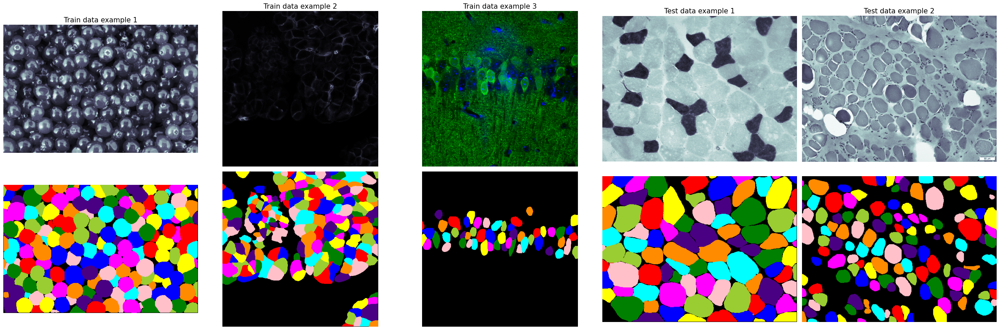

In [7]:
# pick at random from train and test set
train_picks = np.random.choice(a = range(len(train_img_paths)), size = 3, replace=False)
test_picks = np.random.choice(a = range(len(test_img_paths)), size = 2, replace=False)
fig, axs = plt.subplots(ncols=5, nrows=2, figsize=(30,10)) # generate plot with 3 train, 2 test images plus masks
[ax.axis('off') for ax in axs.flat]
for plt_idx, picked_idx in enumerate(train_picks):
    axs[0, plt_idx].set_title(f'Train data example {plt_idx+1}', fontsize=15)
    img = cellpose_img_load(train_img_paths[picked_idx]) 
    if len(img.shape) == 2: # add picked img in first row
        axs[0, plt_idx].imshow(img, cmap='bone')
    else:
        axs[0, plt_idx].imshow(img)
    train_mask = mpimg.imread(train_mask_paths[picked_idx])
    train_mask = np.round(train_mask*(2**16))
    axs[1, plt_idx].imshow(label2rgb(train_mask)) # add picked mask in second row
for plt_idx, picked_idx in enumerate(test_picks):
    img = cellpose_img_load(test_img_paths[picked_idx]) 
    if len(img.shape) == 2: # add picked img in first row
        axs[0, plt_idx+3].imshow(img, cmap='bone')
    else:
        axs[0, plt_idx+3].imshow(img)
    axs[0, plt_idx+3].set_title(f'Test data example {plt_idx+1}', fontsize=15)
    test_mask = mpimg.imread(test_mask_paths[picked_idx])
    test_mask = np.round(test_mask*(2**16))
    axs[1, plt_idx+3].imshow(label2rgb(test_mask)) # add picked mask in second row
plt.tight_layout()
plt.show()

## Load Cellpose model and evaluate on test dataset

### Configure and load model and data loaders

In [8]:
#Define where the patch file will be saved
base = "content/"

initial_model = "cyto2" # Which model to retrain

Channel_to_use_for_training = "Green" #["Grayscale", "Blue", "Green", "Red"]

#If you have a secondary channel that can be used for training, for instance nuclei, choose it here:
Second_training_channel= "Red" # ["None", "Blue", "Green", "Red"]

if len(test_dir) == 0:
    test_dir = None


# Here we match the channel to number
if Channel_to_use_for_training == "Grayscale":
    chan = 0
elif Channel_to_use_for_training == "Blue":
    chan = 3
elif Channel_to_use_for_training == "Green":
    chan = 2
elif Channel_to_use_for_training == "Red":
    chan = 1


if Second_training_channel == "Blue":
    chan2 = 3
elif Second_training_channel == "Green":
    chan2 = 2
elif Second_training_channel == "Red":
    chan2 = 1
elif Second_training_channel == "None":
    chan2 = 0

In [9]:
# start logger (to see training across epochs)
logger = io.logger_setup()

# DEFINE CELLPOSE MODEL (without size model)
model = models.CellposeModel(gpu=use_GPU, model_type=initial_model)

# set channels
channels = [chan, chan2]

# get files
output = io.load_train_test_data(train_dir, test_dir, mask_filter='_masks', image_filter='_img')
train_data, train_labels, _, test_data, test_labels, _ = output

# diameter of labels in training images
diam_labels = model.diam_labels.copy()

2023-03-12 15:10:19,320 [INFO] WRITING LOG OUTPUT TO C:\Users\mairhoermann\.cellpose\run.log
2023-03-12 15:10:19,321 [INFO] 
cellpose version: 	2.2 
platform:       	win32 
python version: 	3.9.16 
torch version:  	1.13.1
2023-03-12 15:10:19,322 [INFO] >> cyto2 << model set to be used
2023-03-12 15:10:19,325 [INFO] ** TORCH CUDA version installed and working. **
2023-03-12 15:10:19,326 [INFO] >>>> using GPU
2023-03-12 15:10:19,984 [INFO] >>>> model diam_mean =  30.000 (ROIs rescaled to this size during training)
2023-03-12 15:10:20,037 [INFO] not all flows are present, running flow generation for all images
2023-03-12 15:10:27,166 [INFO] 540 / 540 images in ..\data\train folder have labels
2023-03-12 15:10:27,166 [INFO] not all flows are present, running flow generation for all images
2023-03-12 15:10:28,069 [INFO] 68 / 68 images in ..\data\test folder have labels


### Evaluate model on cellpose test dataset

In [10]:
# run model on test images
test_masks, test_flows, test_styles  = model.eval(
    test_data, 
    channels=[chan, chan2],
    diameter=diam_labels
)

# run model on train images
train_masks, train_flows, train_styles  = model.eval(
    train_data, 
    channels=[chan, chan2],
    diameter=diam_labels
)

2023-03-12 15:10:37,683 [INFO] 18%|#7        | 12/68 [00:07<00:28,  1.96it/s]


C:\Users\mairhoermann\Anaconda3\envs\antholz23\lib\site-packages\cellpose\transforms.py:361: UserWarning: 'chan2 (opt)' has value range of ZERO, can instead set chan2 to 0
  warnings.warn("'chan2 (opt)' has value range of ZERO, can instead set chan2 to 0")


2023-03-12 15:16:01,322 [INFO] 100%|##########| 540/540 [04:55<00:00,  1.83it/s]


In [11]:
# check performance using ground truth labels
ap, tp, fp, fn = metrics.average_precision(test_labels, test_masks)
print('Segmentation metrics on Test Dataset:')
print(f'>>> average precision at iou threshold 0.5 = {ap[:,0].mean():.3f}')
print(f'>>> true positives at iou threshold 0.5 = {tp[:,0].mean():.3f}')
print(f'>>> false positives at iou threshold 0.5 = {fp[:,0].mean():.3f}')
print(f'>>> false negatives at iou threshold 0.5 = {fn[:,0].mean():.3f}')

Segmentation metrics on Test Dataset:
>>> average precision at iou threshold 0.5 = 0.734
>>> true positives at iou threshold 0.5 = 77.985
>>> false positives at iou threshold 0.5 = 10.059
>>> false negatives at iou threshold 0.5 = 27.912


### Visualize some predictions on the test dataset

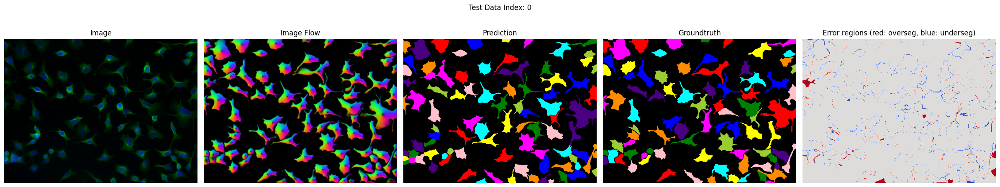

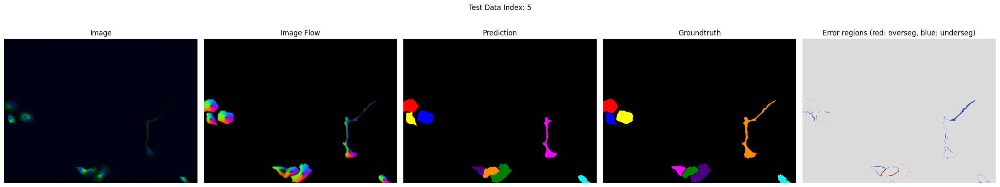

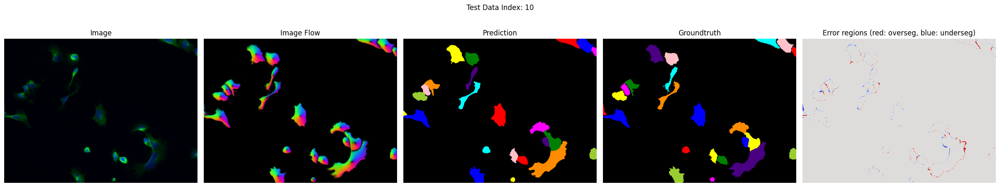

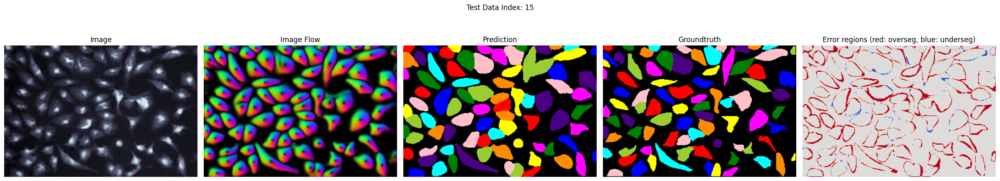

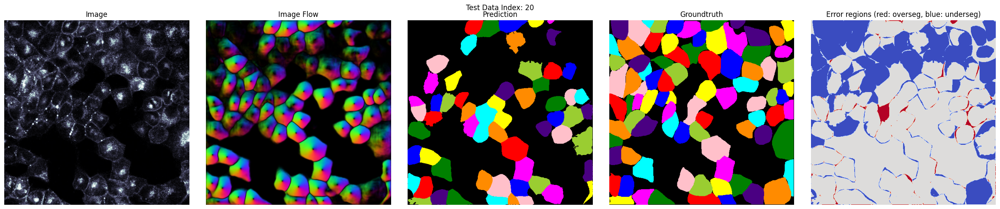

...

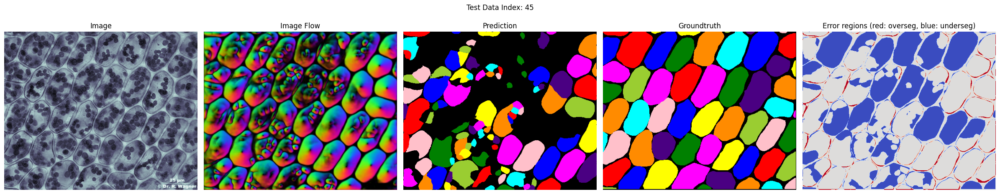

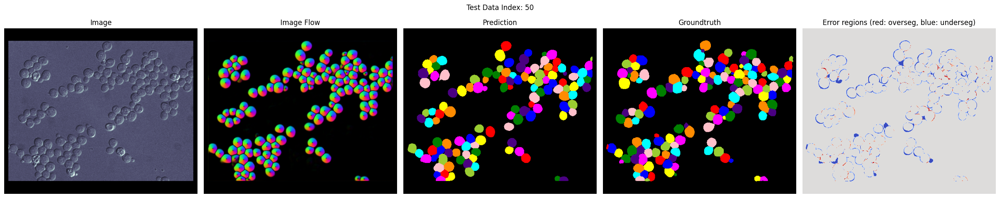

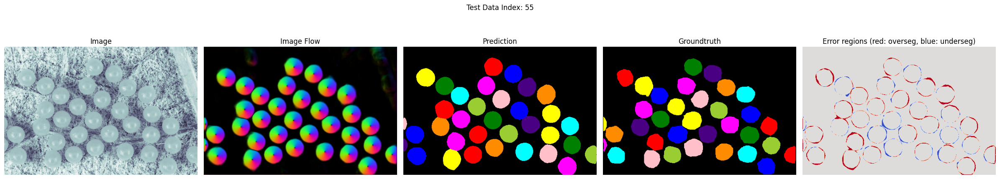

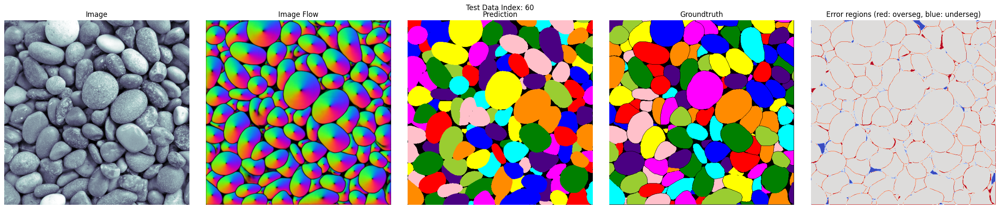

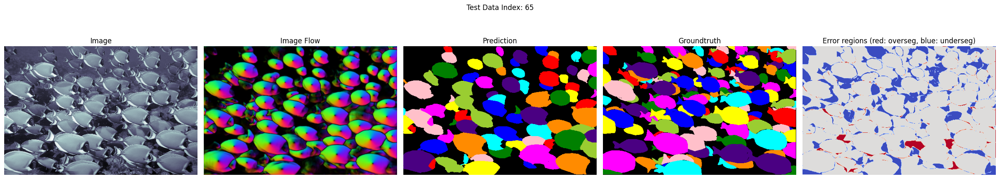

In [12]:
for k,im in enumerate(test_data):
    if k%5==0:
        fig, axs= plt.subplots(ncols=5, figsize=(24,5))
        plt.suptitle(f'Test Data Index: {k}')
        [ax.axis('off') for ax in axs]
        img = cellpose_img_load(img_data=im/2**16)
        if len(img.shape)==2:
            axs[0].imshow(img, cmap='bone')
        elif len(img.shape)==3:
            axs[0].imshow(img)
        axs[0].set_title('Image')
        axs[1].imshow(test_flows[k][0])
        axs[1].set_title('Image Flow')
        axs[2].imshow(label2rgb(test_masks[k]))
        axs[2].set_title('Prediction')
        axs[3].imshow(label2rgb(test_labels[k]))
        axs[3].set_title('Groundtruth')
        axs[4].imshow((test_masks[k]>0).astype(int)-(test_labels[k]>0).astype(int), cmap='coolwarm')
        axs[4].set_title('Error regions (red: overseg, blue: underseg)')
        plt.tight_layout()
        plt.show()

## Explore latent representations

In [13]:
# Combine style representations from train and test data
test_latent_features = np.array(test_styles)
train_latent_features = np.array(train_styles)
all_latent_features = np.concatenate([test_latent_features, train_latent_features])
# build vector indicating train/test split
ds_str = np.array(['Test']*len(test_styles) + ['Train']*len(train_styles))
# build vector containing length of channel dimension
shape_lengths = [len(cellpose_img_load(img_data=img).shape) for img in test_data] + [len(cellpose_img_load(img_data=img).shape) for img in train_data]
is_multichannel = np.array([shape_len==3 for shape_len in shape_lengths])
# build vector containing the number of objects on all groundtruth masks
n_objects = np.array([len(np.unique(test_l)) for test_l in test_labels] + [len(np.unique(train_l)) for train_l in train_labels])

In [14]:
test_latent_features.shape, train_latent_features.shape, all_latent_features.shape, is_multichannel.shape, n_objects.shape

((68, 256), (540, 256), (608, 256), (608,), (608,))

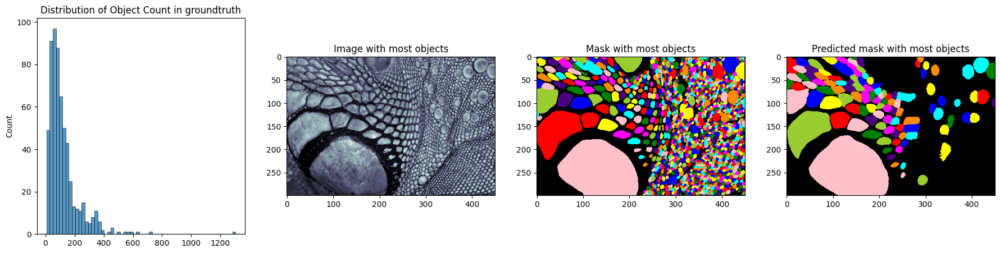

In [15]:
plt.figure(figsize=(22,5))
plt.subplot(141)
sns.histplot(n_objects)
plt.title('Distribution of Object Count in groundtruth')
most_obj_idx = n_objects.argmax()
plt.subplot(142)
plt.title('Image with most objects')
img = (test_data+train_data)[most_obj_idx]
plt.imshow(cellpose_img_load(img_data=img/img.max()), cmap='bone')
plt.subplot(143)
plt.title('Mask with most objects')
plt.imshow(label2rgb((test_labels+train_labels)[most_obj_idx]))
plt.subplot(144)
plt.title('Predicted mask with most objects')
plt.imshow(label2rgb((test_masks+train_masks)[most_obj_idx]))
plt.show()

In [16]:
t_sne = manifold.TSNE(
    n_components=2,
    perplexity=30,
    random_state=0,
)
all_tsne = t_sne.fit_transform(all_latent_features)
plot_data = pd.DataFrame(all_tsne, columns=['x', 'y'])
plot_data['Dataset'] = ds_str
plot_data['is Multi-channel'] = is_multichannel
plot_data['Groundtruth objects'] = n_objects

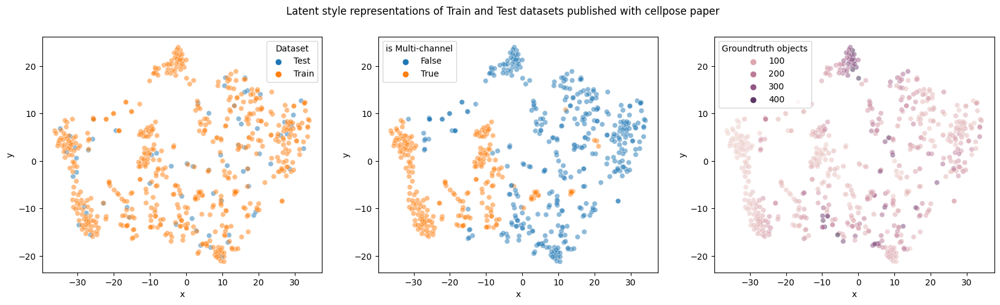

In [18]:
fig, axs = plt.subplots(ncols=3, figsize=(20,5))
plt.suptitle('Latent style representations of Train and Test datasets published with cellpose paper')
sns.scatterplot(
    data=plot_data,
    x='x',
    y='y',
    color='gray',
    ax=axs[0],
    hue='Dataset',
    alpha=0.5
)
sns.scatterplot(
    data=plot_data,
    x='x',
    y='y',
    color='gray',
    ax=axs[1],
    hue='is Multi-channel',
    alpha=0.5
)
display_max_objects=500
sns.scatterplot(
    data=plot_data[plot_data['Groundtruth objects']<display_max_objects],
    x='x',
    y='y',
    hue='Groundtruth objects',
    ax=axs[2],
    alpha=0.5
)
plt.show()

# Exploring and Retraining on Yeast dataset

## Visualize some example images from Yeast dataset

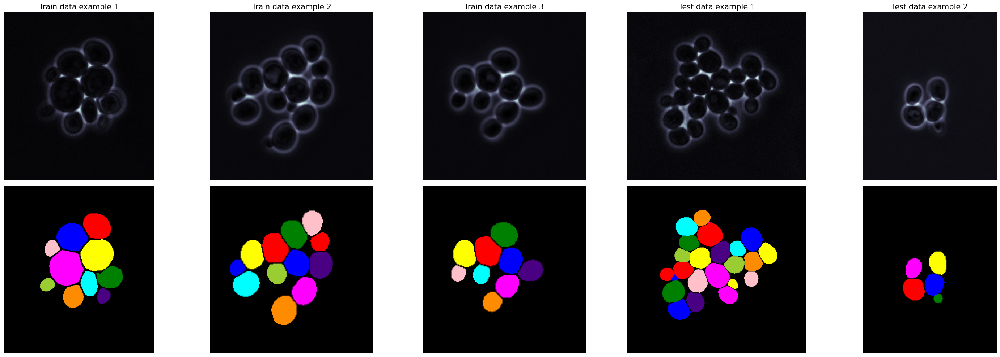

In [19]:
# pick at random from train and test set
train_picks = np.random.choice(a = range(len(re_train_img_paths)), size = 3, replace=False)
test_picks = np.random.choice(a = range(len(re_test_img_paths)), size = 2, replace=False)
fig, axs = plt.subplots(ncols=5, nrows=2, figsize=(30,10)) # generate plot with 3 train, 2 test images plus masks
[ax.axis('off') for ax in axs.flat]
for plt_idx, picked_idx in enumerate(train_picks):
    axs[0, plt_idx].set_title(f'Train data example {plt_idx+1}', fontsize=15)
    img = cellpose_img_load(img_path=re_train_img_paths[picked_idx]) 
    if len(img.shape) == 2: # add picked img in first row
        axs[0, plt_idx].imshow(img, cmap='bone')
    else:
        axs[0, plt_idx].imshow(img)
    train_mask = mpimg.imread(re_train_mask_paths[picked_idx])
    #train_mask = np.round(train_mask*(2**16))
    axs[1, plt_idx].imshow(label2rgb(train_mask*255)) # add picked mask in second row
    #axs[1, plt_idx].imshow(train_mask) # add picked mask in second row
for plt_idx, picked_idx in enumerate(test_picks):
    img = cellpose_img_load(re_test_img_paths[picked_idx]) 
    if len(img.shape) == 2: # add picked img in first row
        axs[0, plt_idx+3].imshow(img, cmap='bone')
    else:
        axs[0, plt_idx+3].imshow(img)
    axs[0, plt_idx+3].set_title(f'Test data example {plt_idx+1}', fontsize=15)
    test_mask = mpimg.imread(re_test_mask_paths[picked_idx])
    #test_mask = np.round(test_mask*(2**16))
    axs[1, plt_idx+3].imshow(label2rgb(test_mask*255)) # add picked mask in second row
plt.tight_layout()
plt.show()

## Initialize dataloader for yeast dataset and evaluate Cyto model before retraining

In [20]:
# get files
output = io.load_train_test_data(re_train_dir, re_test_dir, mask_filter='_masks', image_filter='_img')
re_train_data, re_train_labels, _, re_test_data, re_test_labels, _ = output
# labels stored differently, create dense labels with helper function
re_test_labels = [dense_from_acdc(l) for l in re_test_labels]
re_train_labels = [dense_from_acdc(l) for l in re_train_labels]
# run model on test images
re_test_masks, re_test_flows, re_test_styles  = model.eval(
    re_test_data, 
    channels=[chan, chan2],
    diameter=diam_labels
)

2023-03-12 15:16:55,708 [INFO] not all flows are present, running flow generation for all images
2023-03-12 15:16:55,770 [INFO] 10 / 10 images in ..\data\re_train folder have labels
2023-03-12 15:16:55,777 [INFO] not all flows are present, running flow generation for all images
2023-03-12 15:16:55,870 [INFO] 10 / 10 images in ..\data\re_test folder have labels
2023-03-12 15:16:57,871 [INFO] 0%|          | 0/10 [00:00<?, ?it/s]


C:\Users\mairhoermann\Anaconda3\envs\antholz23\lib\site-packages\cellpose\transforms.py:361: UserWarning: 'chan2 (opt)' has value range of ZERO, can instead set chan2 to 0
  warnings.warn("'chan2 (opt)' has value range of ZERO, can instead set chan2 to 0")


2023-03-12 15:17:01,002 [INFO] 100%|##########| 10/10 [00:03<00:00,  3.19it/s]


In [21]:
ap, tp, fp, fn = metrics.average_precision(re_test_labels, re_test_masks)
print('Segmentation metrics on Re-test Dataset:')
print(f'>>> average precision at iou threshold 0.5 = {ap[:,0].mean():.3f}')
print(f'>>> true positives at iou threshold 0.5 = {tp[:,0].mean():.3f}')
print(f'>>> false positives at iou threshold 0.5 = {fp[:,0].mean():.3f}')
print(f'>>> false negatives at iou threshold 0.5 = {fn[:,0].mean():.3f}')

Segmentation metrics on Re-test Dataset:
>>> average precision at iou threshold 0.5 = 0.799
>>> true positives at iou threshold 0.5 = 7.700
>>> false positives at iou threshold 0.5 = 0.300
>>> false negatives at iou threshold 0.5 = 1.000


## Visualize yeast dataset in latent space (run latent space visualization above first)

In [22]:
# Combine style representations from train and test data
re_test_latent_features = np.array(re_test_styles)
re_all_latent_features = np.concatenate([all_latent_features, re_test_latent_features])
# build vector indicating train/test split
re_ds_str = list(ds_str) + ['Yeast-retraining']*len(re_test_styles)

In [23]:
t_sne = manifold.TSNE(
    n_components=2,
    perplexity=30,
    random_state=0,
)
re_all_tsne = t_sne.fit_transform(re_all_latent_features)
plot_data = pd.DataFrame(re_all_tsne, columns=['x', 'y'])
plot_data['Dataset'] = re_ds_str

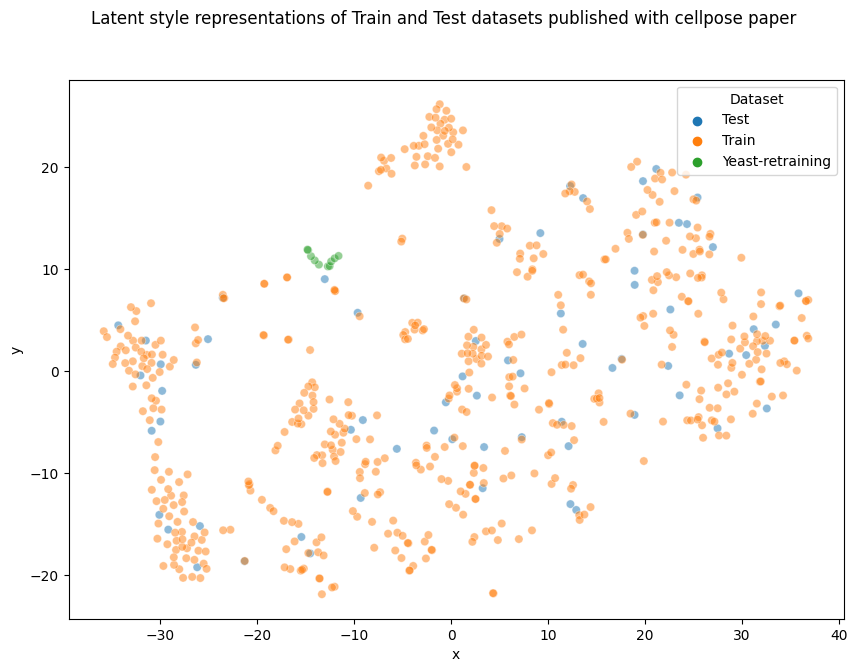

In [24]:
fig, axs = plt.subplots(ncols=1, figsize=(10,7))
plt.suptitle('Latent style representations of Train and Test datasets published with cellpose paper')
sns.scatterplot(
    data=plot_data,
    x='x',
    y='y',
    color='gray',
    ax=axs,
    hue='Dataset',
    alpha=0.5
)
plt.show()

## Visualize predictions of cyto model on yeast dataset before retraining

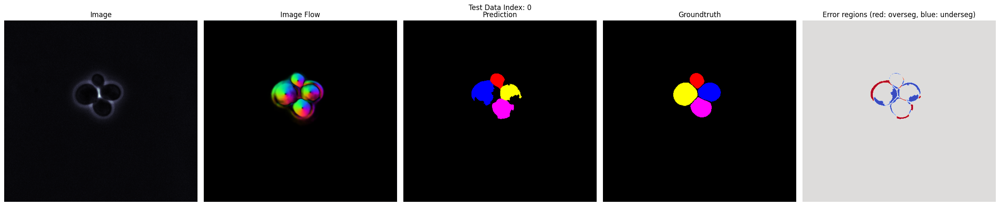

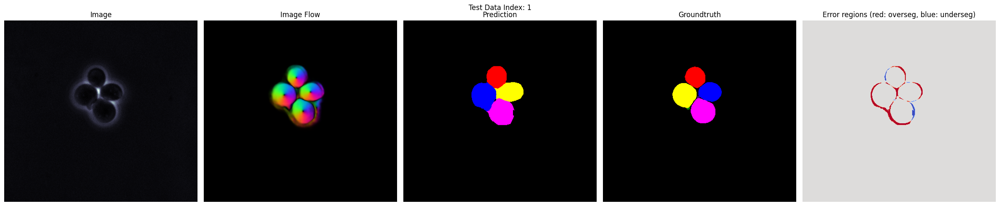

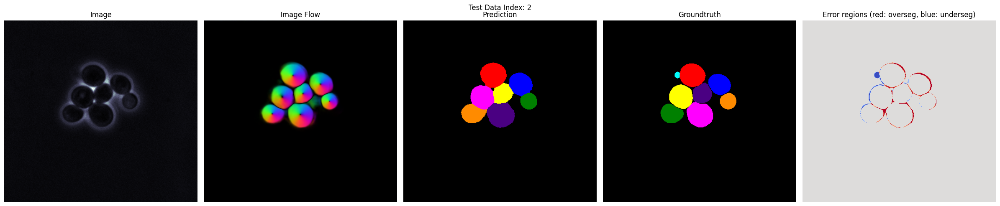

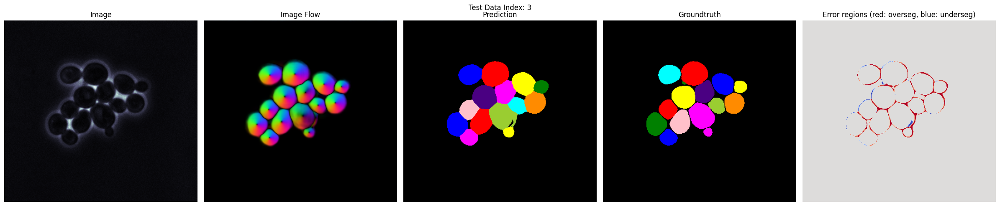

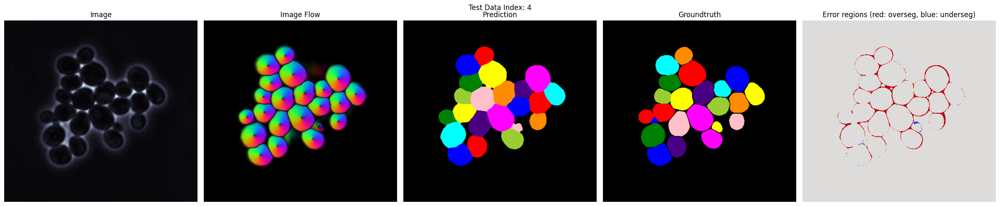

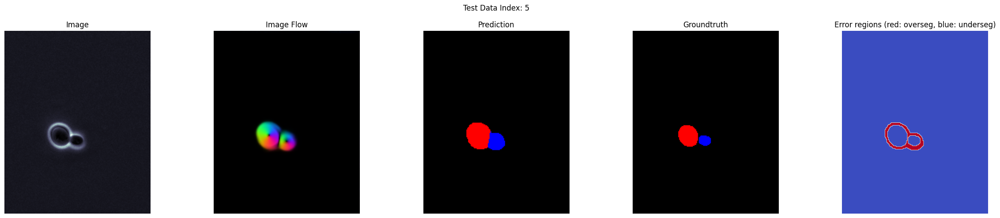

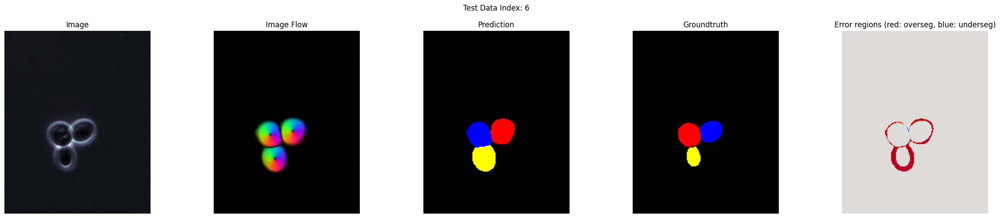

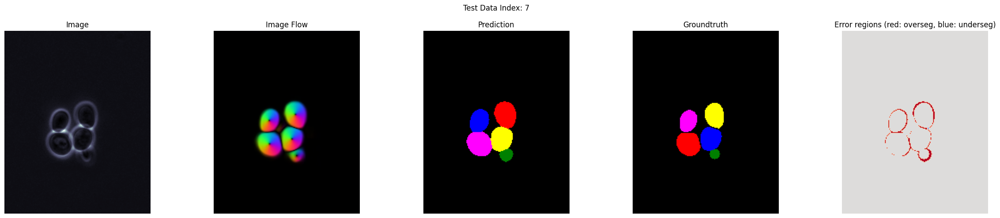

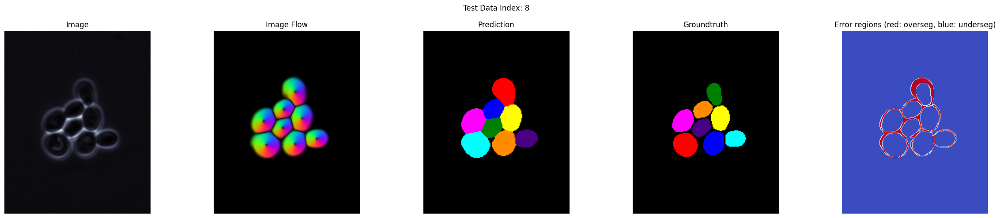

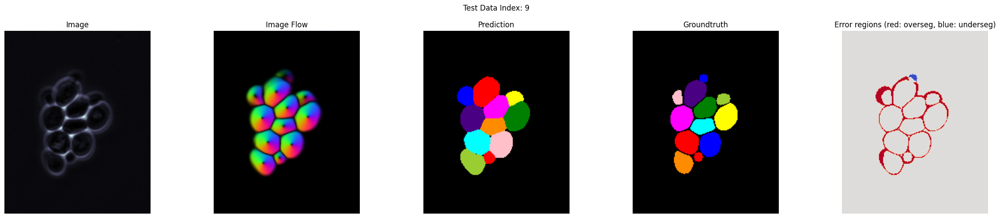

In [25]:
for k,im in enumerate(re_test_data):
    fig, axs= plt.subplots(ncols=5, figsize=(24,5))
    plt.suptitle(f'Test Data Index: {k}')
    [ax.axis('off') for ax in axs]
    img = cellpose_img_load(img_data=im)
    if len(img.shape)==2:
        axs[0].imshow(img, cmap='bone')
    elif len(img.shape)==3:
        axs[0].imshow(img)
    axs[0].set_title('Image')
    axs[1].imshow(re_test_flows[k][0])
    axs[1].set_title('Image Flow')
    axs[2].imshow(label2rgb(re_test_masks[k]))
    axs[2].set_title('Prediction')
    axs[3].imshow(label2rgb(re_test_labels[k]))
    axs[3].set_title('Groundtruth')
    axs[4].imshow((re_test_masks[k]>0).astype(int)-(re_test_labels[k]>0).astype(int), cmap='coolwarm')
    axs[4].set_title('Error regions (red: overseg, blue: underseg)')
    plt.tight_layout()
    plt.show()

## Retrain model on yeast data

In [26]:
# hyper params for retraining
learning_rate = 0.1 
weight_decay = 0.0001
n_epochs =  50
model_name = "CP_yeast" # Name of new model which we will retrain on our data

# here we check that no model with the same name already exist, if so delete
model_path = 'models/'
if os.path.exists(model_path+'/'+model_name):
    print("!! WARNING: "+model_name+" already exists and will be deleted in the following cell !!")

In [27]:
output = io.load_train_test_data(re_train_dir, re_test_dir, mask_filter='_masks', image_filter='_img')
re_train_data, re_train_labels, _, re_test_data, re_test_labels, _ = output
model = models.CellposeModel(gpu=use_GPU, model_type=initial_model)
new_model_path = model.train(
    re_train_data, 
    re_train_labels, 
    test_data=re_test_data,
    test_labels=re_test_labels,
    channels=channels, 
    save_path=model_path, 
    n_epochs=n_epochs,
    learning_rate=learning_rate, 
    weight_decay=weight_decay, 
    nimg_per_epoch=8,
    model_name=model_name
)

2023-03-12 15:18:51,707 [INFO] not all flows are present, running flow generation for all images
2023-03-12 15:18:51,762 [INFO] 10 / 10 images in ..\data\re_train folder have labels
2023-03-12 15:18:51,767 [INFO] not all flows are present, running flow generation for all images
2023-03-12 15:18:51,802 [INFO] 10 / 10 images in ..\data\re_test folder have labels
2023-03-12 15:18:51,817 [INFO] >> cyto2 << model set to be used
2023-03-12 15:18:51,817 [INFO] ** TORCH CUDA version installed and working. **
2023-03-12 15:18:51,817 [INFO] >>>> using GPU
2023-03-12 15:18:51,977 [INFO] >>>> model diam_mean =  30.000 (ROIs rescaled to this size during training)
2023-03-12 15:18:52,061 [INFO] computing flows for labels


C:\Users\mairhoermann\Anaconda3\envs\antholz23\lib\site-packages\cellpose\transforms.py:361: UserWarning: 'chan2 (opt)' has value range of ZERO, can instead set chan2 to 0
  warnings.warn("'chan2 (opt)' has value range of ZERO, can instead set chan2 to 0")
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 13.95it/s]

2023-03-12 15:18:52,810 [INFO] computing flows for labels



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 17.52it/s]

2023-03-12 15:18:53,411 [WARNING] 2 train images with number of masks less than min_train_masks (5), removing from train set


2023-03-12 15:18:53,443 [INFO] >>>> median diameter set to = 30
2023-03-12 15:18:53,443 [INFO] >>>> mean of training label mask diameters (saved to model) 45.737
2023-03-12 15:18:53,443 [INFO] >>>> training network with 2 channel input <<<<
2023-03-12 15:18:53,443 [INFO] >>>> LR: 0.10000, batch_size: 8, weight_decay: 0.00010
2023-03-12 15:18:53,443 [INFO] >>>> ntrain = 8, ntest = 10
2023-03-12 15:18:53,443 [INFO] >>>> nimg_per_epoch = 8
2023-03-12 15:18:54,777 [INFO] Epoch 0, Time  1.3s, Loss 0.2386, Loss Test 0.1175, LR 0.0000
2023-03-12 15:18:55,379 [INFO] saving network parameters to models/models/CP_yeast
2023-03-12 15:18:58,234 [INFO] Epoch 5, Time  4.8s, Loss 0.1791, Loss Test 0.0914, LR 0.0556
2023-03-12 15:19:01,449 [INFO] Epoch 10, Time  8.0s, Loss 0.1056, Loss Test 0.0932, LR 0.1000
2023-03-12 15:19:07,604 [INFO] Epoch 20, Time 14.2s, Loss 0.0811, Loss Test 0.0689, LR 0.1000
2023-03-12 15:19:14,055 [INFO] Epoch 30, Time 20.6s, Loss 0.0596, Loss Test 0.0653, LR 0.1000
2023-03-

## Evaluate retrained model on yeast dataset

In [28]:
# get files
output = io.load_train_test_data(re_train_dir, re_test_dir, mask_filter='_masks', image_filter='_img')
re_train_data, re_train_labels, _, re_test_data, re_test_labels, _ = output
# labels stored differently, create dense labels with helper function
re_test_labels = [dense_from_acdc(l) for l in re_test_labels]
re_train_labels = [dense_from_acdc(l) for l in re_train_labels]
# run model on test images
re_test_masks, re_test_flows, re_test_styles  = model.eval(
    re_test_data, 
    channels=[chan, chan2],
    diameter=diam_labels
)

2023-03-12 15:19:26,629 [INFO] not all flows are present, running flow generation for all images
2023-03-12 15:19:26,660 [INFO] 10 / 10 images in ..\data\re_train folder have labels
2023-03-12 15:19:26,660 [INFO] not all flows are present, running flow generation for all images
2023-03-12 15:19:26,707 [INFO] 10 / 10 images in ..\data\re_test folder have labels
2023-03-12 15:19:31,803 [INFO] 100%|##########| 10/10 [00:03<00:00,  3.30it/s]


In [29]:
ap, tp, fp, fn = metrics.average_precision(re_test_labels, re_test_masks)
print('Segmentation metrics on Re-test Dataset:')
print(f'>>> average precision at iou threshold 0.5 = {ap[:,0].mean():.3f}')
print(f'>>> true positives at iou threshold 0.5 = {tp[:,0].mean():.3f}')
print(f'>>> false positives at iou threshold 0.5 = {fp[:,0].mean():.3f}')
print(f'>>> false negatives at iou threshold 0.5 = {fn[:,0].mean():.3f}')

Segmentation metrics on Re-test Dataset:
>>> average precision at iou threshold 0.5 = 0.907
>>> true positives at iou threshold 0.5 = 7.900
>>> false positives at iou threshold 0.5 = 0.100
>>> false negatives at iou threshold 0.5 = 0.800


## Visualize predictions of model on yeast dataset AFTER retraining

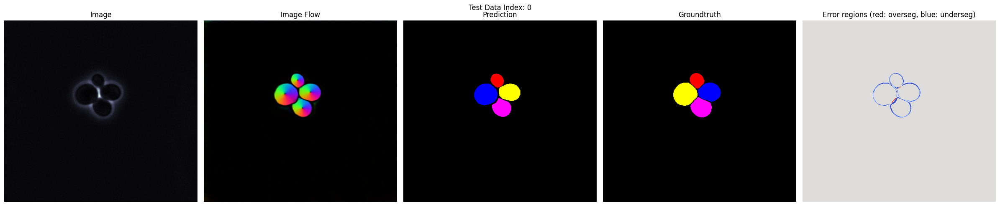

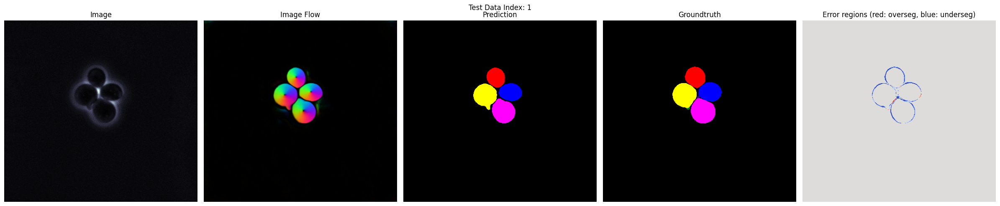

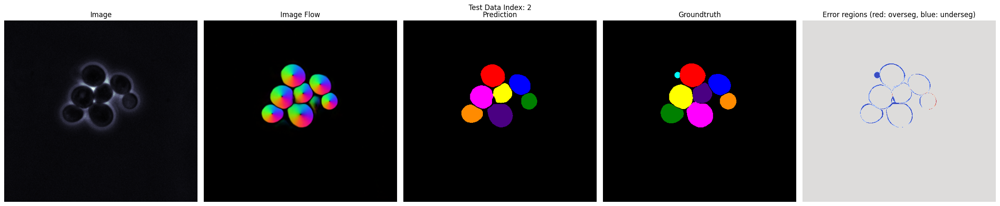

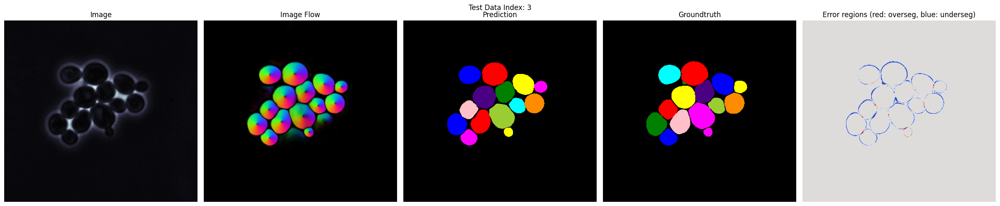

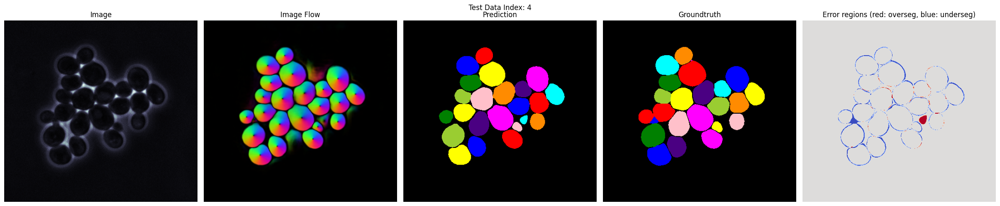

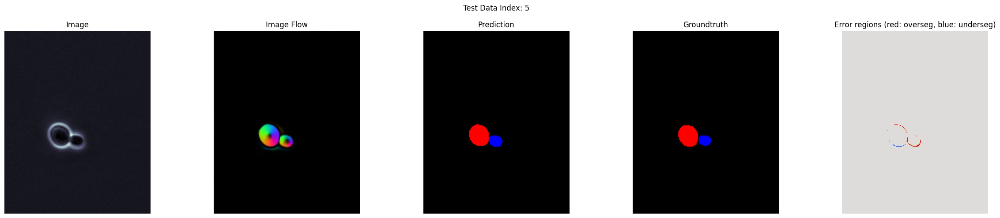

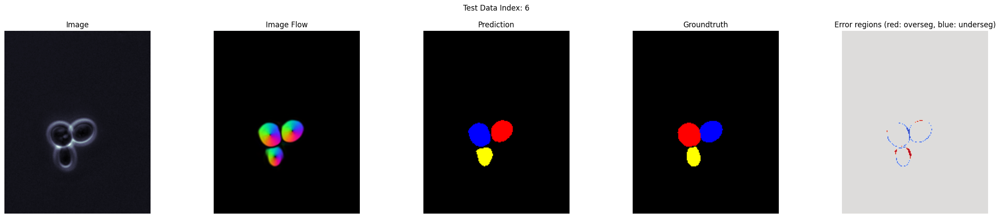

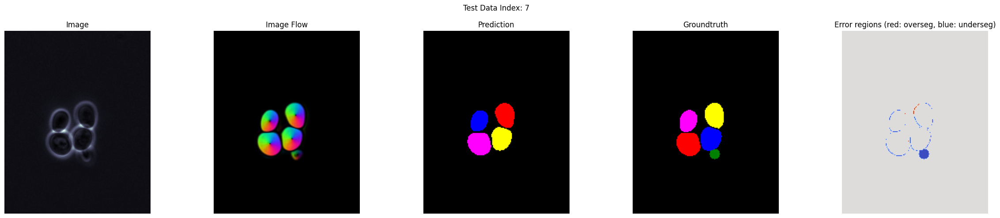

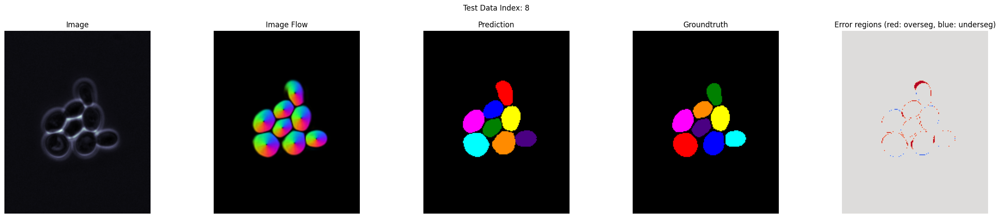

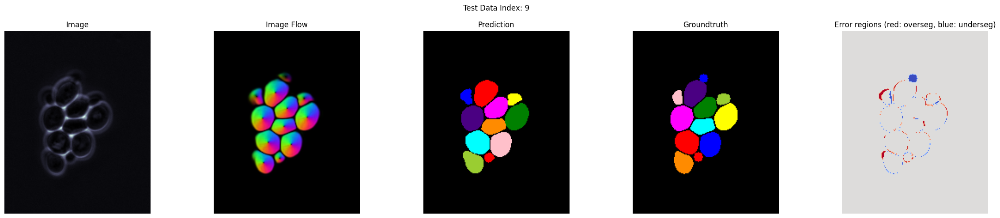

In [30]:
for k,im in enumerate(re_test_data):
    fig, axs= plt.subplots(ncols=5, figsize=(24,5))
    plt.suptitle(f'Test Data Index: {k}')
    [ax.axis('off') for ax in axs]
    img = cellpose_img_load(img_data=im)
    if len(img.shape)==2:
        axs[0].imshow(img, cmap='bone')
    elif len(img.shape)==3:
        axs[0].imshow(img)
    axs[0].set_title('Image')
    axs[1].imshow(re_test_flows[k][0])
    axs[1].set_title('Image Flow')
    axs[2].imshow(label2rgb(re_test_masks[k]))
    axs[2].set_title('Prediction')
    axs[3].imshow(label2rgb(re_test_labels[k]))
    axs[3].set_title('Groundtruth')
    axs[4].imshow((re_test_masks[k]>0).astype(int)-(re_test_labels[k]>0).astype(int), cmap='coolwarm')
    axs[4].set_title('Error regions (red: overseg, blue: underseg)')
    plt.tight_layout()
    plt.show()